# Set-up

In [1]:
# Import Libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from numpy import loadtxt
import os, glob
import geopandas as gpd
import geojsonio
import ipywidgets as widgets
from ipywidgets import interact, interactive, fixed, interact_manual
import math
from IPython.display import Image
from currency_converter import CurrencyConverter
from datetime import date
import psutil
import joblib

# Plotly
import plotly
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
import cufflinks as cf

import chart_studio.plotly as py
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly.subplots import make_subplots
init_notebook_mode(connected=True)
cf.go_offline()
%matplotlib inline
#pd.options.plotting.backend = "plotly"

In [2]:
# Dashboard (Global Variables)
dataset_loc = "amsterdam"  # "berlin", "paris", "amsterdam", "barcelona"
dataset_date = "2020-03-14"  # berlin: "2020-03-17", paris: "2020-03-16", amsterdam: "2020-03-14", barcelona: "2020-03-16", 
model_run = "2020-08-26"               # date of dataset/model creation (determines subfolder for saves of datasets/models)
target = "price"
figcount = 0
figpath = f"data/{dataset_loc}_{dataset_date}/figures_clean/"
curr = CurrencyConverter()
if dataset_loc == "berlin":
    center_coord = (52.5200, 13.4050)
if dataset_loc == "amsterdam":
    center_coord = (52.3727, 4.8931)
if dataset_loc == "paris":
    center_coord = (48.8566, 2.3522)
    
# Table Display Settings
pd.set_option('display.max_columns', 150)
pd.set_option('display.max_rows', 150)
pd.options.display.max_seq_items = 300
pd.set_option('display.max_colwidth', 150)

# Plotting Settings
sns.set(style="white")  #, palette=["#FF5A5F", "#00A699"])
sns.set_palette(sns.color_palette(["#767676", "#FF5A5F", "#00A699"]))

pio.templates.default = "simple_white"
px.defaults.template = "simple_white"  # 'ggplot2', 'seaborn', 'simple_white', 'plotly', 'plotly_white', 'plotly_dark', 'presentation', 'xgridoff', 'ygridoff', 'gridon', 'none'
px.defaults.color_continuous_scale = [
    "#B6B6B6", "#767676", "#FF9A7F", "#FF5A5F"
]  # ["#50D6B9", "#00A699", "#FF9A7F", "#FF5A5F"] #"burgyl"
px.defaults.color_discrete_sequence = ["#767676", "#FF5A5F", "#00A699"]
px.defaults.width = 900
px.defaults.height = 600

In [3]:
# "save_load": Function for saving and loading datasets/models (joblib)
def save_load(data=False, title="unknown", file_format="pkl", function="save", dataset_loc=dataset_loc, dataset_date=dataset_date, model_run=model_run):
    if function=="save":
        joblib.dump(data, f"data/{dataset_loc}_{dataset_date}/{model_run}/{title}.pkl")
#        else:
#            print("Please provide a dataset/model as first input parameter.")
    elif function=="load":
        if file_format=="pkl":
            return joblib.load(f"data/{dataset_loc}_{dataset_date}/{model_run}/{title}.pkl")
        elif file_format=="csv":
            return pd.read_csv(f"data/{dataset_loc}_{dataset_date}/{title}.csv")
        elif file_format=="csv.gz":
            return pd.read_csv(f"data/{dataset_loc}_{dataset_date}/{title}.csv.gz")
        elif file_format=="geojson":
            return pd.read_csv(f"data/{dataset_loc}_{dataset_date}/{title}.geojson")
        else:
            print("Please enter a valid file_format (default is pkl).")

In [4]:
# Import data_clean
data = save_load(title="data_clean", function="load")

In [5]:
# Create path to save figures (if not existing)
if not os.path.exists(figpath):
    os.mkdir(figpath)

In [6]:
# Delete all saved plots (caution!)
del_files = glob.glob(f'{figpath}*')
for f in del_files:
    os.remove(f)

In [7]:
# Function for saving plots with continuous number
def savefig(fig=None, title="Untitled", library="py"):
    global figcount
    global figpath
    existing = False
    filesave = ""
    save_files = glob.glob(f'{figpath}*')
    for f in save_files:
        if title in f:
            existing = True
            filesave = f
    if existing == True:
        if library == "py":
            fig.write_image(filesave)
        elif library == "plt":
            plt.savefig(filesave)
        else:
            print("Please enter valid library ('py', 'plt')")
    else:
        figcount += 1
        if library == "py":
            fig.write_image(f"{figpath}fig{figcount:02d}_{title}.png")
        elif library == "plt":
            plt.savefig(f"{figpath}fig{figcount:02d}_{title}.png")
        else:
            print("Please enter valid library ('py', 'plt')")
            figcount -= 1

# EDA Clean

In [8]:
# Display available columns from "data"
data.columns

Index(['accommodates', 'am_balcony', 'am_breakfast', 'am_child_friendly',
       'am_coffee_machine', 'am_cooking_basics', 'am_elevator',
       'am_essentials', 'am_nature_and_views', 'am_parking', 'am_pets_allowed',
       'am_private_entrance', 'am_smoking_allowed', 'am_tv', 'am_white_goods',
       'amenities', 'availability_365', 'availability_90', 'bathrooms',
       'bedrooms', 'beds', 'calculated_host_listings_count',
       'cancellation_policy', 'cleaning_fee', 'description', 'extra_people',
       'first_review', 'guests_included', 'host_acceptance_rate',
       'host_identity_verified', 'host_is_superhost', 'host_response_rate',
       'host_response_time', 'house_rules', 'instant_bookable', 'interaction',
       'is_location_exact', 'last_review', 'latitude', 'listing_url',
       'longitude', 'maximum_nights', 'minimum_nights', 'monthly_price',
       'name', 'neighborhood_overview', 'neighbourhood_cleansed', 'notes',
       'number_of_reviews', 'number_of_reviews_ltm', '

In [9]:
# Define "reduced_features"
reduced_features = [
    "accommodates",
    "availability_365",
    #                   "availability_90",
    #                   "bathrooms",
    #                   "bedrooms",
    #                   "beds",
    "calculated_host_listings_count",
    "extra_people",
    #                   "guests_included",
    #                   "maximum_nights",
    "minimum_nights",
    "price",
    "review_scores_rating"
]

In [10]:
# Define "key_features"
key_features = [
    "accommodates",
    #                   "availability_365",
    #                   "availability_90",
    #                   "bathrooms",
    #                   "bedrooms",
    #                   "beds",
    "calculated_host_listings_count",
    #                   "extra_people",
    #                   "guests_included",
    #                   "maximum_nights",
    #                   "minimum_nights",
    "price",
    "review_scores_rating",
    "host_is_superhost"
]

In [11]:
# Separate/create variables for numerical and categorical features
num_features = list(data.columns[data.dtypes != object])
cat_features = list(data.columns[data.dtypes == object])
#data_cont = data[num_features]

## Interactive Dashboards

In [12]:
# Display figures from graphical exploration below direcly here in the dashboard
@interact_manual
def show_images(file=sorted(os.listdir(figpath))):
    display(Image(figpath + file))

interactive(children=(Dropdown(description='file', options=(), value=None), Button(description='Run Interact',…

In [13]:
# Display table with all rows where feature value is > x (where x is the selected threshold)
@interact(x=widgets.IntSlider(1, 0, 100, 1, continuous_update=False))
def filter_data(column=num_features, x=10):
    return data.loc[data[column] > x]

interactive(children=(Dropdown(description='column', options=('accommodates', 'am_balcony', 'am_breakfast', 'a…

In [14]:
# Display interactive plot for comparing two features
@interact_manual(
    x=widgets.Dropdown(options=list(data.select_dtypes('number').columns),
                       index=0,
                       description="Feature"),
    y=widgets.Dropdown(options=list(data.select_dtypes('number').columns),
                       value=target,
                       description="Target"),
    kind=widgets.Dropdown(
        options=["bar", "box", "bubble", "heatmap", "histogram", "scatter"],
        value="bar",
        description="Plot Type"))
#                 text='title',
#                 theme=widgets.Dropdown(options=list(cf.themes.THEMES.keys()),description="Theme"),
#                 colorscale=widgets.Dropdown(options=list(cf.colors._scales_names.keys()),description="Colorscale"))
def scatter_plot(x, y, kind):  #,theme,colorscale):

    data.iplot(kind=kind,
               x=x,
               y=y,
               mode='markers',
               xTitle=str(x),
               yTitle=str(y),
               title=f'{str(y)} vs {str(x)}')


#        text=title,
#        theme=theme,
#        colorscale=colorscale)

interactive(children=(Dropdown(description='Feature', options=('accommodates', 'am_balcony', 'am_breakfast', '…

## Tables (non-graphical exploration)

In [15]:
# Get extensive ProfileReport
#profile = ProfileReport(data, title='Pandas Profiling Report', explorative=True)
#profile.to_widgets()
#profile.to_notebook_iframe()

In [16]:
# Examine shape and head/columns of data
print(data.shape)
data.head(1)

(7899, 66)


,accommodates,am_balcony,am_breakfast,am_child_friendly,am_coffee_machine,am_cooking_basics,am_elevator,am_essentials,am_nature_and_views,am_parking,am_pets_allowed,am_private_entrance,am_smoking_allowed,am_tv,am_white_goods,amenities,availability_365,availability_90,bathrooms,bedrooms,beds,calculated_host_listings_count,cancellation_policy,cleaning_fee,description,extra_people,first_review,guests_included,host_acceptance_rate,host_identity_verified,host_is_superhost,host_response_rate,host_response_time,house_rules,instant_bookable,interaction,is_location_exact,last_review,latitude,listing_url,longitude,maximum_nights,minimum_nights,monthly_price,name,neighborhood_overview,neighbourhood_cleansed,notes,number_of_reviews,number_of_reviews_ltm,price,property_type,review_scores_accuracy,review_scores_checkin,review_scores_cleanliness,review_scores_communication,review_scores_location,review_scores_rating,review_scores_value,room_type,security_deposit,space,summary,transit,weekly_price,zipcode
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
20168,2,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,"{TV,Internet,Wifi,""Paid parking off premises"",""Free street parking"",Heating,""Smoke detector"",""Carbon monoxide detector"",""Fire extinguisher"",Essent...",164,52,1.0,1.0,1.0,2,strict_14_with_grace_period,0.0,"17th century Dutch townhouse in the heart of the city. no public transport needed! Located a stones throw from Rembrandt Square, Dam Square, Leids...",0.0,2010-03-02,2,96.0,f,f,100.0,within an hour,This studio/room takes entire floor and has it own small bathroom. Please note we require you to contact us at-least 1-2 week before arrival with ...,t,"No curfew, free entrance 27/7 with your own keys. All rooms are lockable and you feel 100% privacy! Smoking, drugs and night party are strictly fo...",t,2020-03-11,52.36509,https://www.airbnb.com/rooms/20168,4.89354,365,1,0.0,Studio with private bathroom in the centre 1,"Located just in between famous central canals. In the streets surrounding the house, there are lots of antique shops, and for those who are into b...",Centrum-Oost,Check-in time from 2pm till 10pm (But it doesn't mean that I would have to wait all those hours! Note that you have to inform me with estimated ti...,331,74,100.0,Townhouse,10.0,10.0,10.0,10.0,10.0,89.0,9.0,Private room,0.0,"For those who like all facets of city life. In the streets surrounding the house, there are lots of antique shops, and for those who are into brow...","17th century Dutch townhouse in the heart of the city. no public transport needed! Located a stones throw from Rembrandt Square, Dam Square, Leids...","No need to use any transport! All is within a walking distance! But if you like to use the local tram, the stop is just few meters away.",0.0,zip_1017


**Outliers**

In [17]:
# Examine illogical column values (e.g. "accommodates" < "guests_included", "bedrooms" > "beds", ...)
data[data.accommodates - data.beds < 0]

,accommodates,am_balcony,am_breakfast,am_child_friendly,am_coffee_machine,am_cooking_basics,am_elevator,am_essentials,am_nature_and_views,am_parking,am_pets_allowed,am_private_entrance,am_smoking_allowed,am_tv,am_white_goods,amenities,availability_365,availability_90,bathrooms,bedrooms,beds,calculated_host_listings_count,cancellation_policy,cleaning_fee,description,extra_people,first_review,guests_included,host_acceptance_rate,host_identity_verified,host_is_superhost,host_response_rate,host_response_time,house_rules,instant_bookable,interaction,is_location_exact,last_review,latitude,listing_url,longitude,maximum_nights,minimum_nights,monthly_price,name,neighborhood_overview,neighbourhood_cleansed,notes,number_of_reviews,number_of_reviews_ltm,price,property_type,review_scores_accuracy,review_scores_checkin,review_scores_cleanliness,review_scores_communication,review_scores_location,review_scores_rating,review_scores_value,room_type,security_deposit,space,summary,transit,weekly_price,zipcode
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,


**Skew**

In [18]:
# Look at data skew (to check whether scaling with e.g. log makes sense for highly skewed features)
data.skew()

accommodates                      1.013793
am_balcony                        0.632974
am_breakfast                      3.473425
am_child_friendly                 0.626554
am_coffee_machine                -0.437314
am_cooking_basics                -0.062582
am_elevator                       3.028487
am_essentials                    -6.397046
am_nature_and_views               2.639087
am_parking                        0.033180
am_pets_allowed                   2.302564
am_private_entrance               0.317703
am_smoking_allowed                3.696465
am_tv                            -1.191816
am_white_goods                   -1.265490
availability_365                  1.239450
availability_90                   1.041673
bathrooms                         2.510708
bedrooms                          1.521994
beds                              1.686414
calculated_host_listings_count    6.341439
cleaning_fee                      1.104133
extra_people                      4.390600
guests_incl

Features with high skew are engineered in 3_Feature_Engineering and converted into log and/or sqrt.

**Correlation**

In [19]:
# Interactive feature vs. feature correlation check
@interact
def correlations(column1=list(data.select_dtypes('number').columns),
                 column2=list(data.select_dtypes('number').columns)):
    print(f"Correlation: {data[column1].corr(data[column2])}")

interactive(children=(Dropdown(description='column1', options=('accommodates', 'am_balcony', 'am_breakfast', '…

In [20]:
# Full list of correlation values
data.corr()

,accommodates,am_balcony,am_breakfast,am_child_friendly,am_coffee_machine,am_cooking_basics,am_elevator,am_essentials,am_nature_and_views,am_parking,am_pets_allowed,am_private_entrance,am_smoking_allowed,am_tv,am_white_goods,availability_365,availability_90,bathrooms,bedrooms,beds,calculated_host_listings_count,cleaning_fee,extra_people,guests_included,host_acceptance_rate,host_response_rate,latitude,longitude,maximum_nights,minimum_nights,monthly_price,number_of_reviews,number_of_reviews_ltm,price,review_scores_accuracy,review_scores_checkin,review_scores_cleanliness,review_scores_communication,review_scores_location,review_scores_rating,review_scores_value,security_deposit,weekly_price
accommodates,1.000000,0.064689,-0.049754,0.334834,0.054558,0.103666,-0.020330,0.016068,0.031534,0.060910,0.042555,0.130492,-0.015670,0.160979,0.156936,0.002217,-0.050068,0.306949,0.737997,0.789397,0.015604,0.363660,0.171200,0.458518,-0.110308,-0.026260,0.002028,0.043067,0.002583,0.041312,0.048390,-0.121424,-0.142507,0.532842,-0.060096,-0.026027,-0.059857,-0.032725,-0.051753,-0.026051,-0.042514,0.109410,0.102701
am_balcony,0.064689,1.000000,-0.047899,0.074683,0.390085,0.480321,0.028574,0.072696,0.123077,0.231009,0.018639,0.057170,-0.016962,0.076156,0.187138,-0.068978,-0.066404,0.094697,0.087262,0.044653,-0.083647,0.077243,0.043058,0.056613,-0.020936,0.046134,-0.033668,-0.000316,-0.065088,0.014267,0.007727,-0.043982,-0.050987,0.068979,0.114791,0.083811,0.094268,0.101557,-0.007625,0.143576,0.095048,0.029801,0.010836
am_breakfast,-0.049754,-0.047899,1.000000,-0.001850,-0.044429,-0.067753,0.015404,0.010230,0.024344,0.018135,0.048608,0.000854,0.081532,-0.028783,-0.035268,0.073318,0.048139,-0.006584,-0.061354,-0.025700,0.048385,-0.102411,0.004246,-0.040764,0.032673,-0.003706,0.007023,0.038388,-0.008643,-0.027303,-0.026303,0.067091,0.049917,-0.062812,-0.025480,0.018798,0.007629,0.001616,-0.005329,0.003061,0.030192,-0.015363,-0.020731
am_child_friendly,0.334834,0.074683,-0.001850,1.000000,0.119398,0.114256,-0.028172,0.017956,0.062247,0.162647,0.125145,-0.031880,-0.024375,0.129631,0.110711,0.045054,-0.042106,0.131401,0.328349,0.335508,-0.035773,0.157372,0.120328,0.251949,-0.123610,-0.014571,0.024719,0.041672,-0.053372,0.063733,0.128447,0.109783,-0.004050,0.181451,0.039705,0.061446,0.015248,0.051660,-0.043273,0.029458,0.009096,0.080807,0.198735
am_coffee_machine,0.054558,0.390085,-0.044429,0.119398,1.000000,0.518379,-0.031825,0.085488,0.148760,0.277484,0.024210,0.116204,-0.045558,0.081386,0.141855,0.006453,-0.003215,0.099871,0.056692,0.059866,-0.084327,0.082606,0.067715,0.098925,0.062670,0.111971,0.011748,0.003606,-0.074315,-0.011900,0.033275,0.081329,0.110565,0.094577,0.144287,0.104376,0.149900,0.102817,0.073053,0.162221,0.115884,0.056391,0.033974
am_cooking_basics,0.103666,0.480321,-0.067753,0.114256,0.518379,1.000000,0.022774,0.093051,0.088452,0.280350,0.018436,0.116416,-0.006858,0.110368,0.349957,-0.158547,-0.146389,0.120831,0.118157,0.071517,-0.146389,0.115853,0.109710,0.110575,-0.068333,0.057560,0.000502,-0.005240,-0.064567,0.033596,0.014148,-0.131031,-0.154845,0.127811,0.105081,0.116583,0.094885,0.125225,0.015804,0.157822,0.097774,0.077325,0.021385
am_elevator,-0.020330,0.028574,0.015404,-0.028172,-0.031825,0.022774,1.000000,0.005859,0.035894,0.072984,-0.012813,-0.024847,0.043609,0.030619,0.058903,0.003119,0.033754,0.002923,-0.014427,-0.013468,-0.020668,-0.041293,0.014912,-0.011075,-0.024218,-0.021211,-0.057539,-0.010434,-0.035679,0.049214,0.002333,-0.049656,-0.055516,-0.034641,-0.007767,-0.005614,0.003558,0.007492,-0.105836,0.007782,0.010110,0.022604,0.008256
am_essentials,0.016068,0.072696,0.010230,0.017956,0.085488,0.093051,0.005859,1.000000,0.040099,0.109467,0.010500,0.077109,-0.004111,0.037655,0.062474,-0.042381,-0.010773,0.025637,0.005611,0.010675,-0.086933,0.009131,-0.018771,-0.010626,0.016587,0.024506,-0.013530,0.011298,-0.002829,-0.000864,-0.033669,0.024525,0.029106,0.026866,0.062530,0.047539,0.081786,0.048372,0.034964,0.081839,0.074860,0

## Plot visualizations (graphical exploration)

In [21]:
# Histogram of price
fig = px.histogram(
    data,
    x="price",
    title="Price Histogram",
    #             color="host_is_superhost",
    marginal="rug",  # 'rug', 'box', 'violin', 'histogram'
    nbins=50)

fig.show()
savefig(fig, title="histogram_price")

Price is strongly skewed to the right and will be replaced with its log.

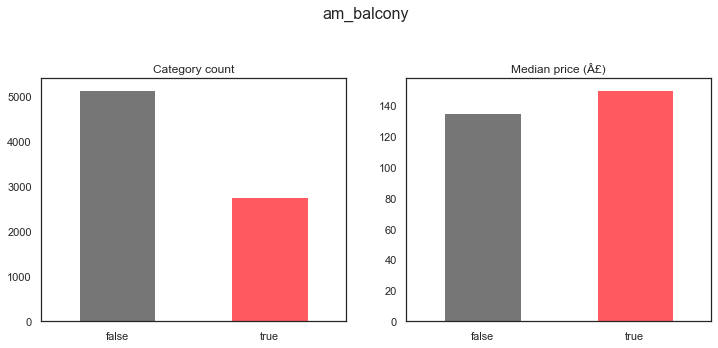

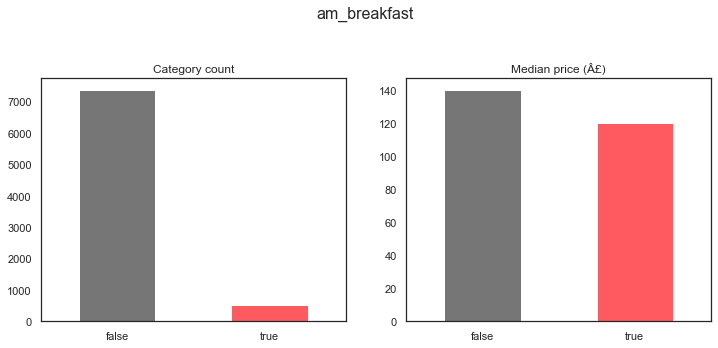

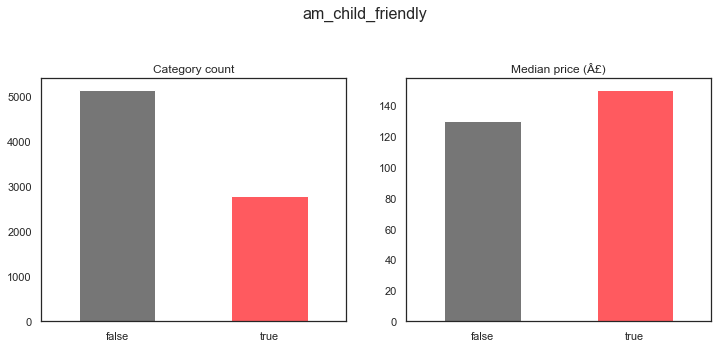

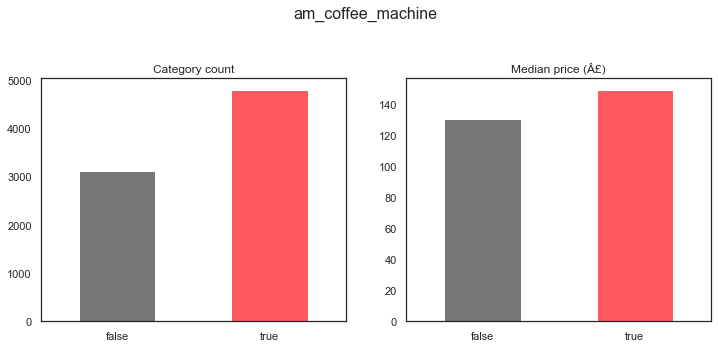

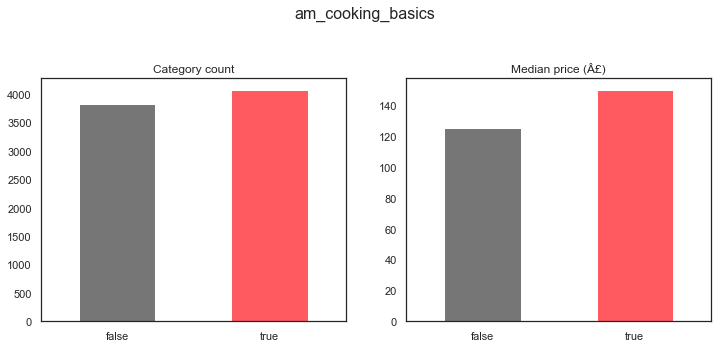

...

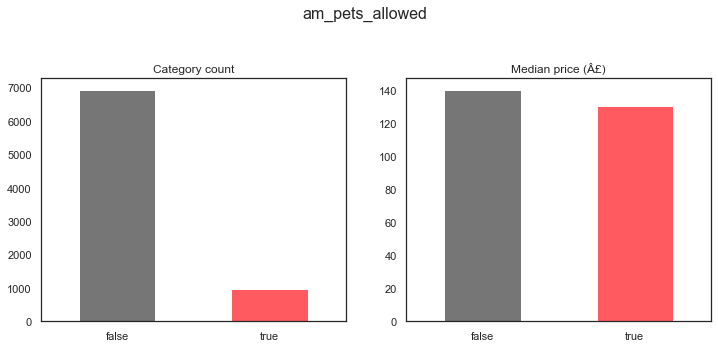

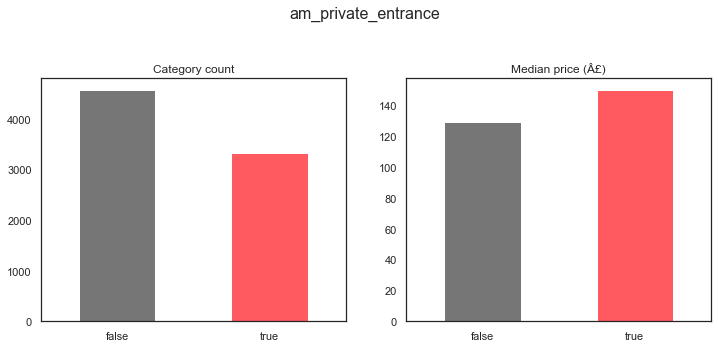

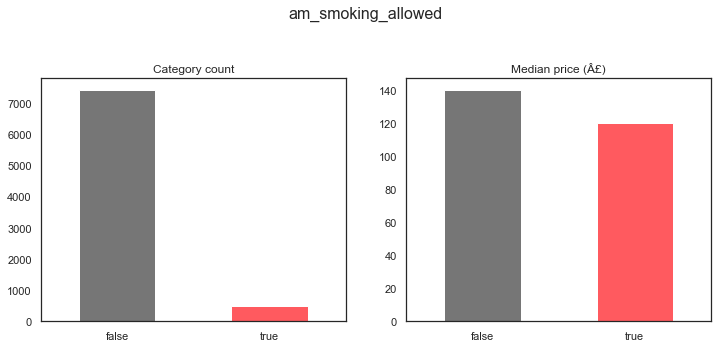

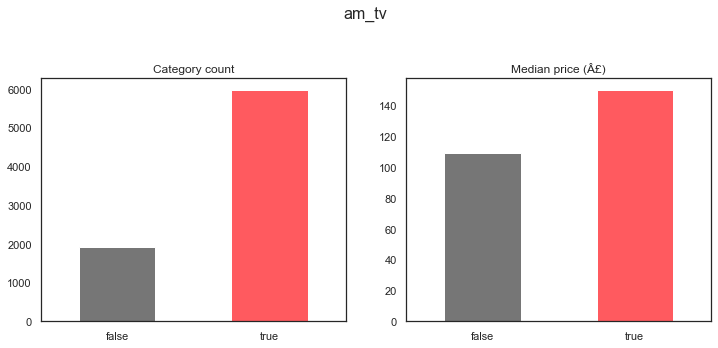

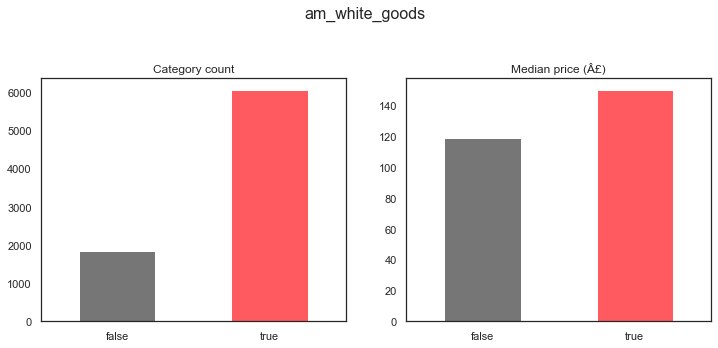

In [22]:
# Count and median price for amenities
am_col = [el for el in data.columns if el.startswith("am_")]

for col in am_col:
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
    fig.suptitle(col, fontsize=16, y=1)
    plt.subplots_adjust(
        top=0.80
    )  # So that the suptitle does not overlap with the ax plot titles

    data.groupby(col).size().plot(kind='bar',
                                  ax=ax1,
                                  color=["#767676", "#FF5A5F"])
    ax1.set_xticklabels(labels=['false', 'true'], rotation=0)
    ax1.set_title('Category count')
    ax1.set_xlabel('')

    data.groupby(col).price.median().plot(kind='bar',
                                          ax=ax2,
                                          color=["#767676", "#FF5A5F"])
    ax2.set_xticklabels(labels=['false', 'true'], rotation=0)
    ax2.set_title('Median price (Â£)')
    ax2.set_xlabel('')

    plt.show()

Most amenities show a strong positive relationship with median price. The only major exception is - unsurprisingly - am_smoking_allowed. Some others are less meaningful due to very inbalanced classes.

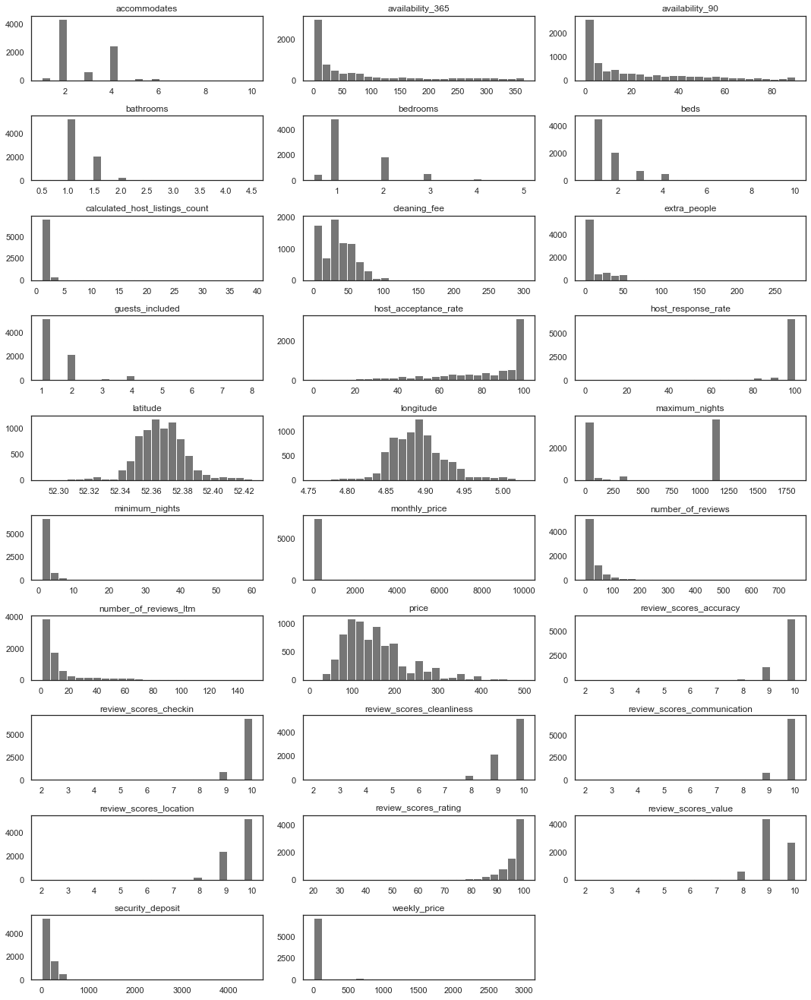

In [23]:
# Histogram of numerical features except amenities
hist_col = [el for el in num_features if el not in am_col]
data[hist_col].hist(figsize=(15, 20),
                    bins=25,
                    layout=(int(len(hist_col) / 3) + 1, 3),
                    grid=False)
plt.tight_layout()
savefig(title="histogram_num_features", library="plt")

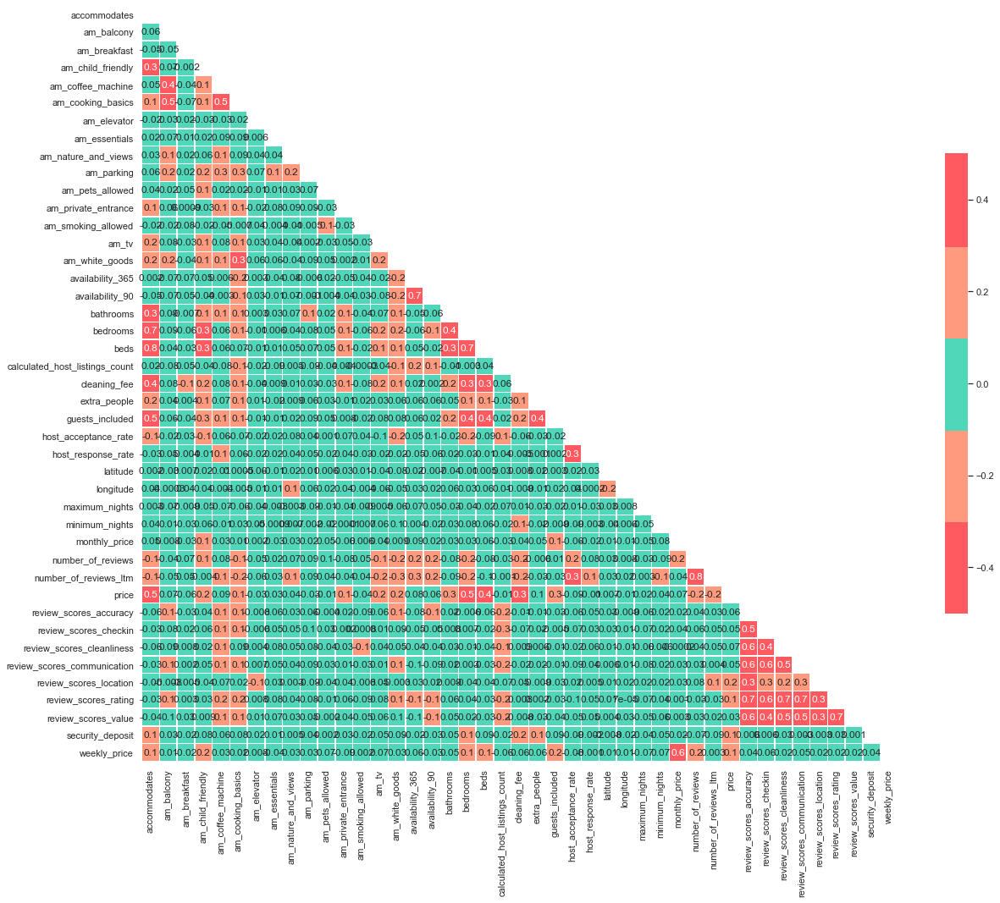

In [24]:
# Correlation heatmap for numerical features (Version 1)
#Generate a mask for the upper triangle
mask = np.triu(np.ones_like(data[num_features].corr(), dtype=np.bool))

#Set up the matplotlib figure
f, ax = plt.subplots(figsize=(20, 20))

#Generate a custom diverging colormap
#cmap = sns.diverging_palette(220, 10, as_cmap=True)
#cmap = [(0, 166, 153), (255, 90, 95)]

#Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(data[num_features].corr(),
            mask=mask,
            cmap=["#FF5A5F", "#FF9A7F", "#50D6B9", "#FF9A7F", "#FF5A5F"],
            vmax=.5,
            vmin=-.5,
            center=0,
            square=True,
            linewidths=.5,
            cbar_kws={"shrink": .5},
            annot=True,
            fmt=".1g")

savefig(title="full_heatmap", library="plt")

Highly correlated features will be removed from the analysis. For this purpose, the threshold is roughly set at two correlations of 0.4 or above. Hence, the following features are removed:

| **FEATURE** | **REASONING** |
| :----- | :----- |
| **am_cooking_basics** | Particularly high correlation with **am_coffee_machine** and **am_balcony** |
| **bedroom** and **beds** | High correlation with each other, with **accommodates** and similar correlation with other features: Combine accommodates and beds to new feature |
| **security_deposit** and **space** | Similar correlation to **cleaning_fee** or **extra_people**: Potentially make a numerical feature counting amount of "special" features instead (0-4) |
| **** |  |



In [25]:
# Correlation heatmap for numerical features (Version 2)
corr = data[num_features].corr().copy()
N = len(num_features)
#hovertext = [[f'corr({num_features[i]}, {num_features[j]})= {corr[i][j]:.2f}' if i>j else '' for j in range(N)] for i in range(N)]

heatmp = go.Heatmap(z=corr,
                    x=num_features,
                    y=num_features,
                    xgap=1,
                    ygap=1,
                    text=corr,
                    colorbar_thickness=20,
                    colorbar_ticklen=3,
                    colorscale=[[0, 'rgb(255, 255, 255)'],
                                [0.5, 'rgb(255, 90, 95)'],
                                [1.0, 'rgb(0, 0, 0)']])

#data = [trace]
layout = go.Layout(title_text="Correlation Heatmap Numerical Features",
                   title_x=0.5,
                   xaxis_showgrid=False,
                   yaxis_showgrid=False,
                   yaxis_autorange='reversed',
                   width=900,
                   height=900)
fig = go.Figure(data=heatmp, layout=layout)

fig.show()
#savefig(fig, title="scatter_price_vs_accommodates")

In [26]:
# Scatterplot y=price x=accommodates
fig = px.scatter(data,
                 x='accommodates',
                 y='price',
                 title='Price vs. Accommodates',
                 color='host_is_superhost',
                 marginal_y='violin',
                 marginal_x='box',
                 trendline='ols',
                 opacity=0.3)
fig.show()
savefig(fig, title="scatter_price_vs_accommodates")

Superhosts achieve a higher price on average, even though this relationship does not appear to be particularly strong.

In [27]:
# Histogram/facet grid instant_bookable vs. room_type
fig = px.histogram(
    data,
    x='instant_bookable',
    title='Bookable vs. Room Type',
    color='host_is_superhost',
    barmode='relative',  # 'group', 'overlay', 'relative'
    facet_row='host_identity_verified',
    facet_col='room_type',
)
fig.show()
savefig(fig, title="facet_bookable_vs_room_type")

No particularly strong distinction is observable when looking at instant bookability compared to host_is_superhost and room_type.

In [28]:
# Scatter Matrix of select features
fig = px.scatter_matrix(data,
                        dimensions=key_features,
                        color='room_type',
                        opacity=0.5,
                        width=1000,
                        title="Scatter Matrix",
                        height=1000)
fig.show()
savefig(fig, title="matrix_key_features")

In [29]:
# Plot histogram of review_scores_rating
fig = px.histogram(data,
                   x="review_scores_rating",
                   color="host_is_superhost",
                   marginal="rug",
                   title="Review Scores Histogram",
                   nbins=50)

fig.show()
savefig(fig, title="histogram_review_scores")

Clearly and unsurprisingly superhosts achieve higher ratings - less though for 100% ratings, which may be listings with fewer reviews and perfect ratings.

In [30]:
# Violinplot price vs. property_type
fig = px.violin(data,
                y="price",
                x="property_type",
                color="host_is_superhost",
                box=True,
                title="Price vs. Property Type",
                points="all")
fig.show()
savefig(fig, title="violin_price_vs_property_type")

Price varies substantially among different property_types.

In [31]:
# Stripplot price vs room_type
fig = px.strip(data,
               x="price",
               y="room_type",
               orientation="h",
               title="Price vs. Room Type",
               color="host_is_superhost")
fig.show()
savefig(fig, title="strip_price_vs_roomtype")

Even more so, price appears to be heavily driven by room_type.

## Map visualizations (graphical exploration)

In [32]:
# Prepare geojson and data_geo

# Load up the file
geojson = gpd.read_file(f'data/{dataset_loc}_{dataset_date}/neighbourhoods.geojson')

# Creating a dataframe of listing counts and median price by borough
data_geo = pd.DataFrame(data.groupby('neighbourhood_cleansed').size())
data_geo.rename(columns={0: 'number_of_listings'}, inplace=True)
data_geo['median_price'] = data.groupby(
    'neighbourhood_cleansed').price.median().values

# Joining the dataframes
#data_geo_map = geojson.set_index('neighbourhood').join(data_geo)
data_geo["neighbourhood"] = data_geo.index

In [33]:
# Map with all listings
fig = px.scatter_mapbox(
    data,
    title=f"{dataset_loc.capitalize()} | All Listings",
    lat="latitude",
    lon="longitude",
    color="price",
    size="accommodates",
    size_max=15,
    hover_name="room_type",
    hover_data={
        "latitude": False,
        "longitude": False,
        "bedrooms": True,
        "price": True,
        "neighbourhood_cleansed": False
    },
    #    range_color=[10,200],
    zoom=10,
    opacity=0.8,
    mapbox_style="carto-positron")

fig.show()
savefig(fig, title=f"{dataset_loc}_map_all_listings")

In [34]:
# Map with listings per "neighbourhood_cleansed"
fig = px.choropleth_mapbox(data_geo,
                           title=f"{dataset_loc.capitalize()} | Listings per Neighbourhood",
                           geojson=geojson,
                           color="number_of_listings",
                           locations="neighbourhood",
                           featureidkey="properties.neighbourhood",
                           center={
                               "lat": center_coord[0],
                               "lon": center_coord[1]
                           },
                           hover_name="neighbourhood",
                           hover_data={
                               "number_of_listings": True,
                               "median_price": True,
                               "median_price": ":.2f",
                               "neighbourhood": False
                           },
                           mapbox_style="carto-positron",
                           zoom=9,
                           opacity=0.5)
fig.show()
savefig(fig, title=f"{dataset_loc}_map_listings_per_neighbh")

Most listings can be found in the centre and east side of Berlin.

In [35]:
# Map with prices per "neighbourhood_cleansed"
fig = px.choropleth_mapbox(data_geo,
                           title=f"{dataset_loc.capitalize()} | Avg Prices per Neighbourhood",
                           geojson=geojson,
                           color="median_price",
                           locations="neighbourhood",
                           featureidkey="properties.neighbourhood",
                           center={
                               "lat": center_coord[0],
                               "lon": center_coord[1]
                           },
                           hover_name="neighbourhood",
                           hover_data={
                               "number_of_listings": True,
                               "median_price": ":.2f",
                               "neighbourhood": False
                           },
                           mapbox_style="carto-positron",
                           zoom=9,
                           opacity=0.5)
fig.show()
savefig(fig, title=f"{dataset_loc}_map_price_per_neighbh")

Prices, however, do not directly coincide with number of listings, as many areas to the west and also some outside areas appear to have higher prices than some eastern areas.

# EDA Engineered

In [36]:
# Dashboard (Global Variables)
target = "price_log"
figcount = 0
figpath = f"data/{dataset_loc}_{dataset_date}/figures_engineered/"

# Plotting Settings
sns.set(style="white")  #, palette=["#FF5A5F", "#00A699"])
sns.set_palette(
    sns.color_palette(
        ["#767676", "#00A699", "#FF5A5F", "#F9C70C", "#FC642D", "#484848"]))

pio.templates.default = "simple_white"
px.defaults.template = "simple_white"  # 'ggplot2', 'seaborn', 'simple_white', 'plotly', 'plotly_white', 'plotly_dark', 'presentation', 'xgridoff', 'ygridoff', 'gridon', 'none'
px.defaults.color_continuous_scale = [
    "#00A699", "#50D6B9", "#FF9A7F", "#FF5A5F"
]  # ["#50D6B9", "#00A699", "#FF9A7F", "#FF5A5F"] #"burgyl"
px.defaults.color_discrete_sequence = [
    "#767676", "#00A699", "#FF5A5F", "#F9C70C", "#FC642D", "#484848"
]
px.defaults.width = 900
px.defaults.height = 600

In [37]:
# Import data_engineered
data = save_load(title="data_engineered", function="load")

In [38]:
# Create path to save figures (if not existing)
if not os.path.exists(figpath):
    os.mkdir(figpath)

In [39]:
# Delete all saved plots (caution!)
del_files = glob.glob(f'{figpath}*')
for f in del_files:
    os.remove(f)

In [40]:
# Display available columns from "data"
data.columns

Index(['accommodates', 'accommodates_per_bed', 'am_balcony', 'am_breakfast',
       'am_child_friendly', 'am_elevator', 'am_essentials',
       'am_nature_and_views', 'am_pets_allowed', 'am_private_entrance',
       'am_smoking_allowed', 'am_tv', 'am_white_goods', 'availability_90',
       'bathrooms_log', 'bedrooms', 'calc_host_lst_count_sqrt_log',
       'cancellation_policy', 'first_review_days_sqrt', 'guests_included_calc',
       'host_acceptance_rate', 'host_is_superhost', 'host_response_rate',
       'host_response_time', 'instant_bookable', 'last_review_days_sqrt',
       'latitude', 'listing_no', 'longitude', 'maximum_nights',
       'minimum_nights_sqrt', 'neighbourhood_cleansed',
       'number_of_reviews_ltm_log', 'occupancy_class', 'occupancy_rate',
       'price', 'price_calc_log', 'price_class', 'price_extra_fees_sqrt',
       'price_extra_people', 'price_log', 'property_type',
       'review_scores_calc', 'review_scores_class', 'review_scores_class_new',
       'review_

In [41]:
# Define "reduced_features"
reduced_features = [
    "accommodates",
    "availability_365",
    #                   "availability_90",
    #                   "bathrooms",
    #                   "bedrooms",
    #                   "beds",
    "calculated_host_listings_count",
    "extra_people",
    #                   "guests_included",
    #                   "maximum_nights",
    "minimum_nights",
    "price",
    "review_scores_rating"
]

In [42]:
# Separate/create variables for numerical and categorical features
num_features = list(data.columns[data.dtypes != object])
cat_features = list(data.columns[data.dtypes == object])
#data_cont = data[num_features]

## Interactive Dashboards

In [43]:
# Display figures from graphical exploration below direcly here in the dashboard
@interact_manual
def show_images(file=sorted(os.listdir(figpath))):
    display(Image(figpath + file))

interactive(children=(Dropdown(description='file', options=(), value=None), Button(description='Run Interact',…

In [44]:
# Display table with all rows where feature value is > x (where x is the selected threshold)
@interact(x=widgets.IntSlider(1, 0, 100, 1, continuous_update=False))
def filter_data(column=num_features, x=10):
    return data.loc[data[column] > x]

interactive(children=(Dropdown(description='column', options=('accommodates', 'accommodates_per_bed', 'am_balc…

In [45]:
# Display interactive plot for comparing two features
@interact_manual(
    x=widgets.Dropdown(options=list(data.select_dtypes('number').columns),
                       index=0,
                       description="Feature"),
    y=widgets.Dropdown(options=list(data.select_dtypes('number').columns),
                       value=target,
                       description="Target"),
    kind=widgets.Dropdown(
        options=["bar", "box", "bubble", "heatmap", "histogram", "scatter"],
        value="bar",
        description="Plot Type"))
#                 text='title',
#                 theme=widgets.Dropdown(options=list(cf.themes.THEMES.keys()),description="Theme"),
#                 colorscale=widgets.Dropdown(options=list(cf.colors._scales_names.keys()),description="Colorscale"))
def scatter_plot(x, y, kind):  #,theme,colorscale):

    data.iplot(kind=kind,
               x=x,
               y=y,
               mode='markers',
               xTitle=str(x),
               yTitle=str(y),
               title=f'{str(y)} vs {str(x)}')


#        text=title,
#        theme=theme,
#        colorscale=colorscale)

interactive(children=(Dropdown(description='Feature', options=('accommodates', 'accommodates_per_bed', 'am_bal…

## Tables (non-graphical exploration)

In [46]:
#profile = ProfileReport(data, title='Pandas Profiling Report', explorative=True)
#profile.to_widgets()
#profile.to_notebook_iframe()

In [47]:
# Examine shape and head/columns of data
print(data.shape)
data.head(1)

(7862, 51)


,accommodates,accommodates_per_bed,am_balcony,am_breakfast,am_child_friendly,am_elevator,am_essentials,am_nature_and_views,am_pets_allowed,am_private_entrance,am_smoking_allowed,am_tv,am_white_goods,availability_90,bathrooms_log,bedrooms,calc_host_lst_count_sqrt_log,cancellation_policy,first_review_days_sqrt,guests_included_calc,host_acceptance_rate,host_is_superhost,host_response_rate,host_response_time,instant_bookable,last_review_days_sqrt,latitude,listing_no,longitude,maximum_nights,minimum_nights_sqrt,neighbourhood_cleansed,number_of_reviews_ltm_log,occupancy_class,occupancy_rate,price,price_calc_log,price_class,price_extra_fees_sqrt,price_extra_people,price_log,property_type,review_scores_calc,review_scores_class,review_scores_class_new,review_scores_location,review_scores_rating_sqrt,room_type,text_len_sqrt,wk_mth_discount,zipcode
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
20168,2,2.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,52,0.0,1.0,0.346574,strict,60.539243,2,96.0,0,100.0,within an hour,1,1.732051,52.36509,20168,4.89354,365,1.0,Centrum-Oost,8.602325,1,1.0,100.0,4.60517,9,0.0,0.0,4.60517,House,88.755051,1,1,10.0,5.627647,Private room,0.764568,0.0,zip_1017


**Outliers**

In [48]:
# Examine illogical column values (e.g. "accommodates" < "guests_included", "bedrooms" > "beds", ...)
#data[data.accommodates-data.beds < 0]

**Skew**

In [49]:
# Look at data skew (to check whether scaling with e.g. log makes sense for highly skewed features)
data.skew()

accommodates                    1.016413
accommodates_per_bed            1.189194
am_balcony                      0.631848
am_breakfast                    3.467428
am_child_friendly               0.629501
am_elevator                     3.022231
am_essentials                  -6.419301
am_nature_and_views             2.641962
am_pets_allowed                 2.299801
am_private_entrance             0.315803
am_smoking_allowed              3.704846
am_tv                          -1.194202
am_white_goods                 -1.269198
availability_90                 1.045480
bathrooms_log                   1.169769
bedrooms                        1.523317
calc_host_lst_count_sqrt_log    2.744995
first_review_days_sqrt          0.050942
guests_included_calc            1.162980
host_acceptance_rate           -1.122689
host_is_superhost               1.039049
host_response_rate             -4.430674
instant_bookable                0.853054
last_review_days_sqrt           0.595000
latitude        

**Correlation**

In [50]:
# Interactive feature vs. feature correlation check
@interact
def correlations(column1=list(data.select_dtypes('number').columns),
                 column2=list(data.select_dtypes('number').columns)):
    print(f"Correlation: {data[column1].corr(data[column2])}")

interactive(children=(Dropdown(description='column1', options=('accommodates', 'accommodates_per_bed', 'am_bal…

In [51]:
# Full list of correlation values
data.corr()

,accommodates,accommodates_per_bed,am_balcony,am_breakfast,am_child_friendly,am_elevator,am_essentials,am_nature_and_views,am_pets_allowed,am_private_entrance,am_smoking_allowed,am_tv,am_white_goods,availability_90,bathrooms_log,bedrooms,calc_host_lst_count_sqrt_log,first_review_days_sqrt,guests_included_calc,host_acceptance_rate,host_is_superhost,host_response_rate,instant_bookable,last_review_days_sqrt,latitude,listing_no,longitude,maximum_nights,minimum_nights_sqrt,number_of_reviews_ltm_log,occupancy_class,occupancy_rate,price,price_calc_log,price_class,price_extra_fees_sqrt,price_extra_people,price_log,review_scores_calc,review_scores_class,review_scores_class_new,review_scores_location,review_scores_rating_sqrt,text_len_sqrt,wk_mth_discount
accommodates,1.000000,-0.038021,0.064696,-0.049446,0.335110,-0.020782,0.016411,0.033329,0.043663,0.129398,-0.015073,0.160018,0.155763,-0.049246,0.293320,0.737894,-0.001618,0.015429,0.705831,-0.110658,-0.058109,-0.026526,-0.057858,0.087789,0.002453,-0.026685,0.042980,0.002220,0.079946,-0.141651,-0.097800,-0.106043,0.532221,0.445184,0.342626,0.198439,0.248435,0.524434,-0.043645,-0.012336,-0.052159,-0.051399,-0.016574,0.073802,0.019910
accommodates_per_bed,-0.038021,1.000000,0.008613,-0.030808,-0.099917,-0.025359,-0.002558,-0.023156,-0.024964,-0.009973,0.010582,0.001909,0.011749,-0.045356,-0.096319,-0.283436,-0.078810,-0.032594,-0.086310,-0.006101,-0.015852,-0.019174,-0.026839,-0.014626,0.001402,0.034724,-0.038167,0.030591,-0.055868,-0.025444,-0.011489,-0.013923,-0.071062,-0.029597,0.019976,-0.013390,0.030191,-0.036864,0.003868,0.002133,0.001743,-0.005079,0.002017,-0.058174,-0.005964
am_balcony,0.064696,0.008613,1.000000,-0.047819,0.075397,0.028846,0.072083,0.124209,0.018558,0.057626,-0.017876,0.076093,0.186823,-0.065822,0.104810,0.086611,-0.124033,0.044454,0.037045,-0.020280,0.055685,0.046653,-0.085105,0.018681,-0.033754,-0.044393,-0.000595,-0.065574,0.022242,-0.034154,-0.051675,-0.059017,0.069063,0.075188,0.081527,0.069959,0.056112,0.087447,0.145494,0.138987,0.151021,-0.006905,0.136442,0.137868,0.009269
am_breakfast,-0.049446,-0.030808,-0.047819,1.000000,-0.001124,0.015332,0.009955,0.024756,0.047220,0.001043,0.082336,-0.028235,-0.034847,0.047883,-0.018033,-0.061103,0.087262,-0.011941,-0.079974,0.032536,0.050745,-0.003559,0.040031,-0.017091,0.006993,0.016522,0.040096,-0.009353,-0.051596,0.041155,0.020025,0.026008,-0.063082,-0.066746,-0.069793,-0.065755,0.026027,-0.071133,0.004663,0.011432,0.016397,-0.006171,0.008491,-0.003767,-0.018478
am_child_friendly,0.335110,-0.099917,0.075397,-0.001124,1.000000,-0.027534,0.018437,0.062842,0.127057,-0.031861,-0.022630,0.128232,0.109019,-0.041079,0.123638,0.328284,-0.060444,0.417777,0.230275,-0.123939,0.023163,-0.014611,-0.099697,0.116025,0.023475,-0.435430,0.041718,-0.052500,0.102252,0.000898,-0.056809,-0.069197,0.182263,0.150818,0.137520,0.144827,0.126268,0.193167,0.019497,-0.038013,-0.051903,-0.042614,-0.043334,0.159946,0.142232
am_elevator,-0.020782,-0.025359,0.028846,0.015332,-0.027534,1.000000,0.005528,0.036348,-0.012853,-0.025743,0.044230,0.030209,0.058493,0.034428,0.012203,-0.015240,-0.000792,-0.036411,-0.031539,-0.024345,-0.012464,-0.021026,-0.012451,0.041921,-0.056188,0.029482,-0.011209,-0.036449,0.036033,-0.061518,-0.040229,-0.049779,-0.034560,-0.057748,-0.074977,0.002088,0.024912,-0.057092,-0.002042,0.018818,-0.000022,-0.105527,0.018707,-0.036934,0.005911
am_essentials,0.016411,-0.002558,0.072083,0.009955,0.018437,0.005528,1.000000,0.039788,0.010027,0.076387,-0.004728,0.037086,0.062138,-0.009652,0.029825,0.004602,-0.074692,-0.036420,0.005816,0.016293,0.063545,0.024746,-0.016568,-0.004785,-0.011687,0.040952,0.011254,-0.002771,-0.006312,0.032526,0.016671,0.018058,0.028067,0.043062,0.043007,0.021316,0.009093,0.045990,0.083913,0.078741,0.087457,0.033780,0.074782,0.049800,-0.032275
am_nature_and_views,0.033329,-0.023156,0.124209,0.024756,0.062842,0.036348,0.039788,1.000000,0.034899,0.086729,-0.012149,-0.039037,-0.039920,0.065065,0.063149,0.0373

## Plot visualizations (graphical exploration)

In [52]:
# Histogram of price_log
fig = px.histogram(
    data,
    x="price_log",
    title="Price Histogram",
    #             color="host_is_superhost",
    marginal="rug",  # 'rug', 'box', 'violin', 'histogram'
    nbins=50)

fig.show()
savefig(fig, title="histogram_price_log")

The log of price now is a lot closer to a Gaussian distribution as compared to original price.

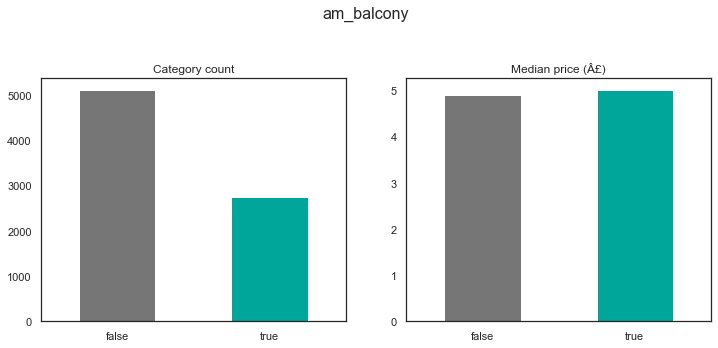

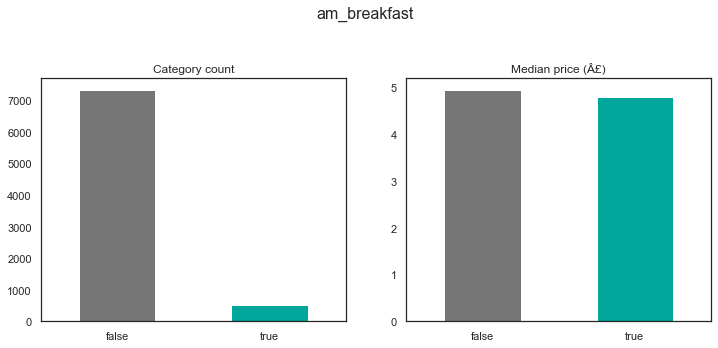

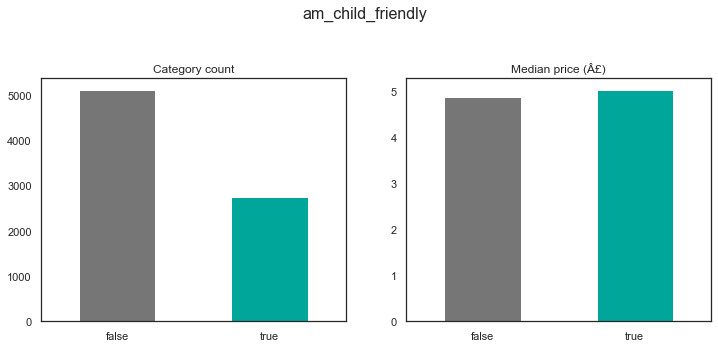

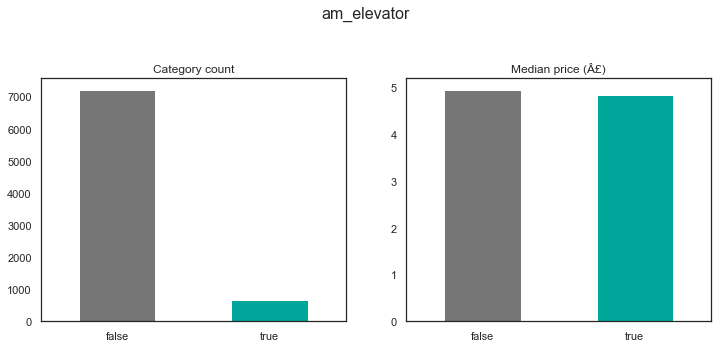

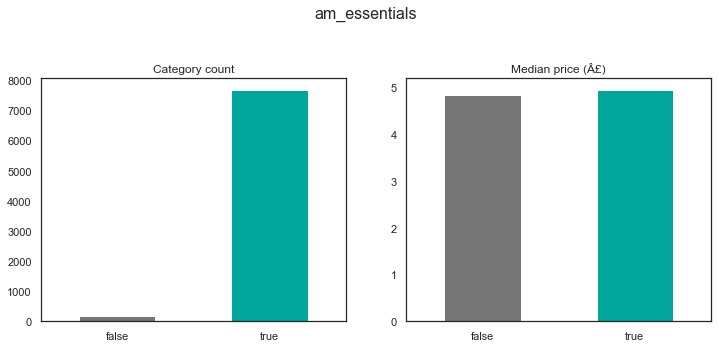

...

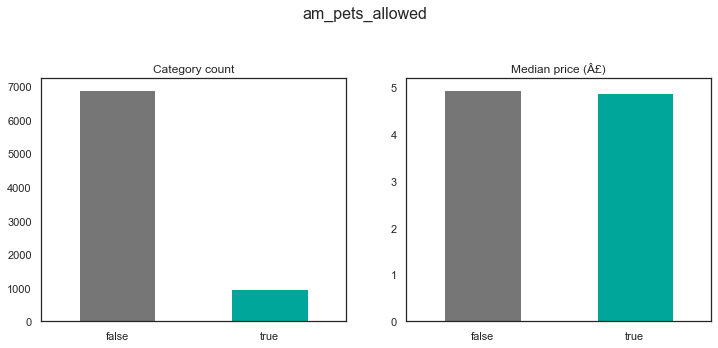

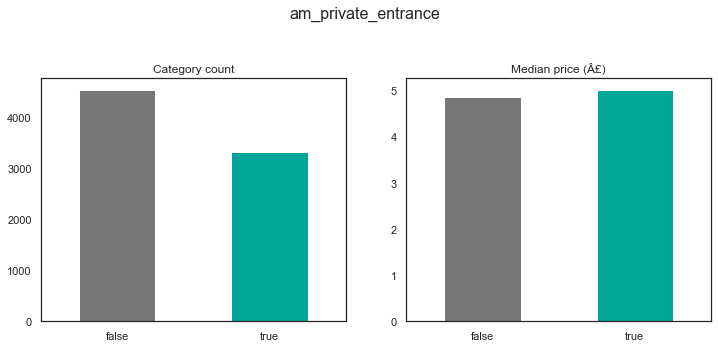

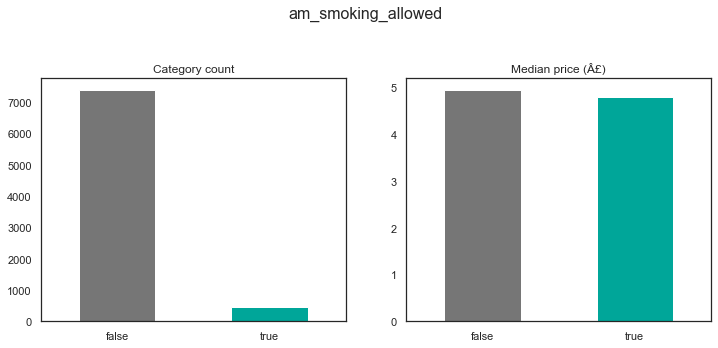

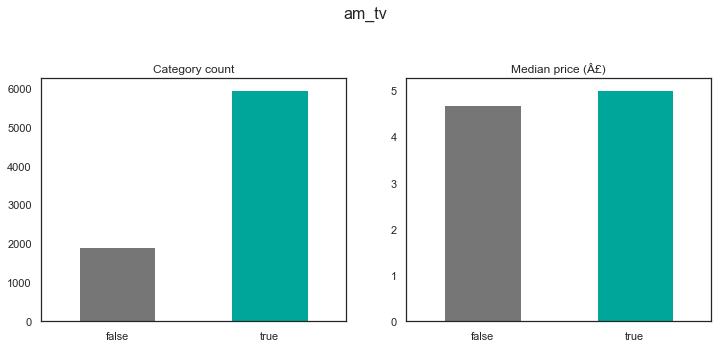

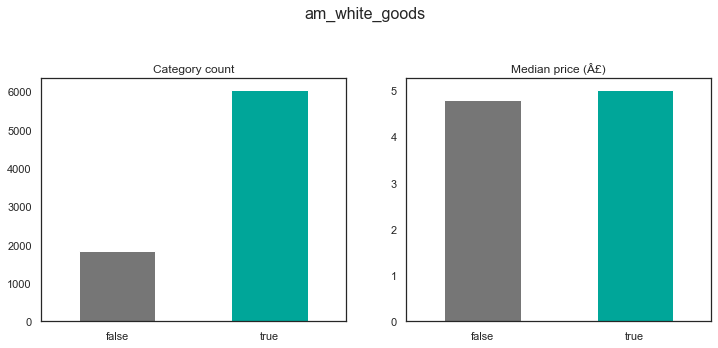

In [53]:
# Count and median price for amenities
am_col = [el for el in data.columns if el.startswith("am_")]

for col in am_col:
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
    fig.suptitle(col, fontsize=16, y=1)
    plt.subplots_adjust(
        top=0.80
    )  # So that the suptitle does not overlap with the ax plot titles

    data.groupby(col).size().plot(kind='bar',
                                  ax=ax1,
                                  color=["#767676", "#00A699"])
    ax1.set_xticklabels(labels=['false', 'true'], rotation=0)
    ax1.set_title('Category count')
    ax1.set_xlabel('')

    data.groupby(col).price_log.median().plot(kind='bar',
                                              ax=ax2,
                                              color=["#767676", "#00A699"])
    ax2.set_xticklabels(labels=['false', 'true'], rotation=0)
    ax2.set_title('Median price (Â£)')
    ax2.set_xlabel('')

    plt.show()

Measured against price_log, the differences among amenities are visually not as clear as in 2_EDA_Clean against price, but still show the same tendencies.

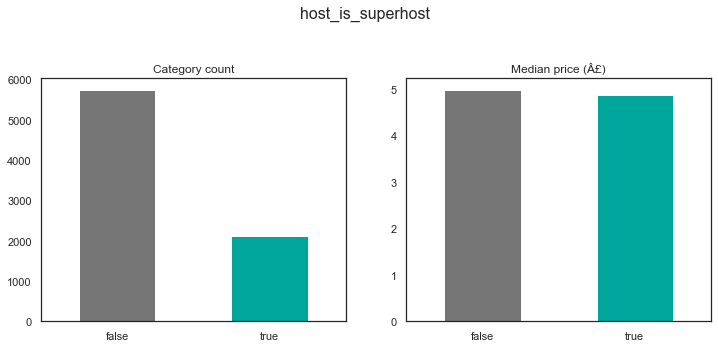

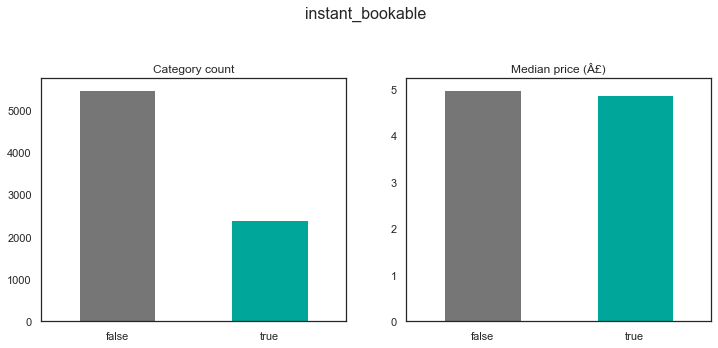

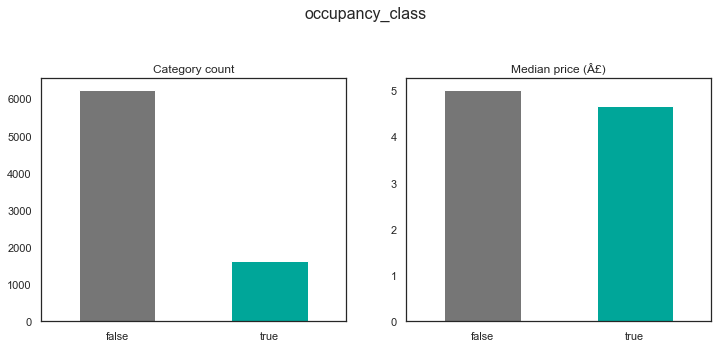

In [54]:
# Count and median price for binary columns
bin_col = ["host_is_superhost", "instant_bookable", "occupancy_class"]

for col in bin_col:
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
    fig.suptitle(col, fontsize=16, y=1)
    plt.subplots_adjust(
        top=0.80
    )  # So that the suptitle does not overlap with the ax plot titles

    data.groupby(col).size().plot(kind='bar',
                                  ax=ax1,
                                  color=["#767676", "#00A699"])
    ax1.set_xticklabels(labels=['false', 'true'], rotation=0)
    ax1.set_title('Category count')
    ax1.set_xlabel('')

    data.groupby(col).price_log.median().plot(kind='bar',
                                              ax=ax2,
                                              color=["#767676", "#00A699"])
    ax2.set_xticklabels(labels=['false', 'true'], rotation=0)
    ax2.set_title('Median price (Â£)')
    ax2.set_xlabel('')

    plt.show()

Superhost and instant bookability appear to have a slightly positive relationship, while occupancy class - with its limitations laid out under 3_Feature_Engineering - does not show an impact on median price.

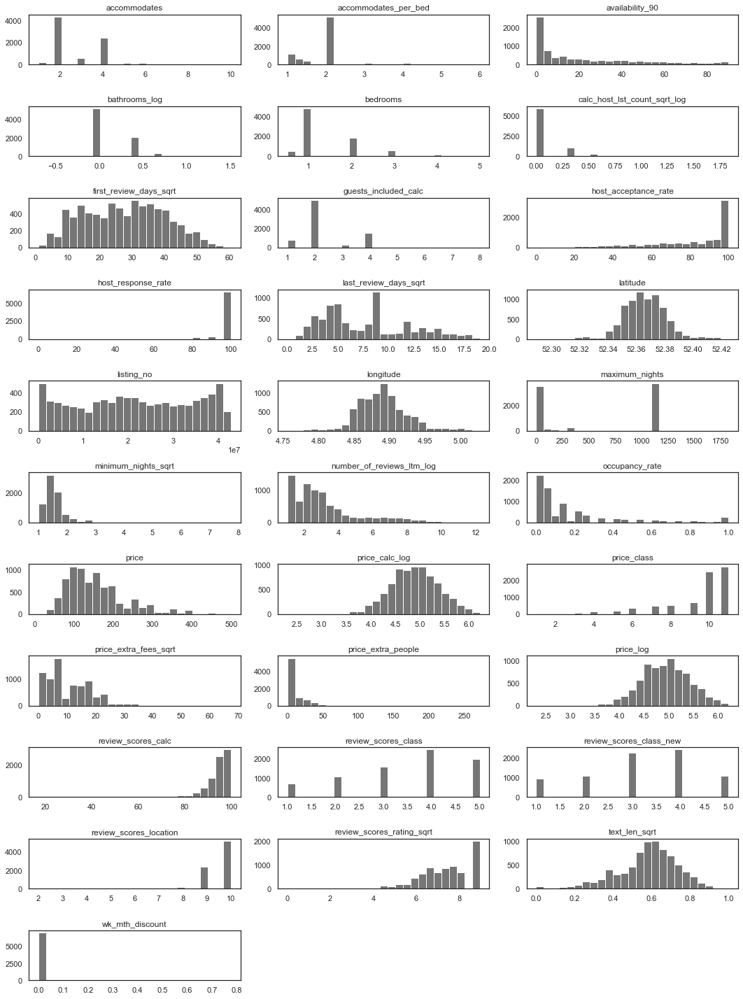

In [55]:
# Histogram of numerical features except amenities
hist_col = [el for el in num_features if el not in am_col]
hist_col = [el for el in hist_col if el not in bin_col]

data[hist_col].hist(figsize=(15, 20),
                    bins=25,
                    layout=(int(len(hist_col) / 3) + 1, 3),
                    grid=False)
plt.tight_layout()
savefig(title="histogram_num_features", library="plt")

Many features appear more balanced after transformation to log and/or sqrt.

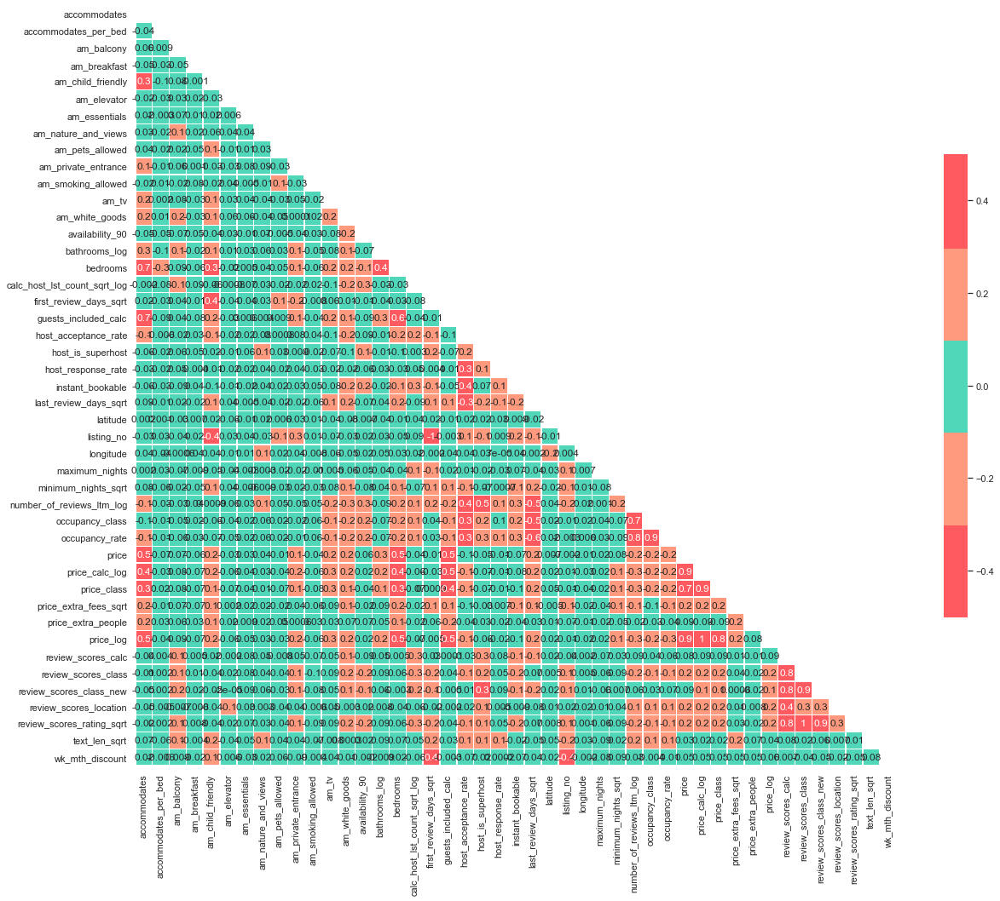

In [56]:
# Correlation heatmap for numerical features (Version 1)
#Generate a mask for the upper triangle
mask = np.triu(np.ones_like(data[num_features].corr(), dtype=np.bool))

#Set up the matplotlib figure
f, ax = plt.subplots(figsize=(20, 20))

#Generate a custom diverging colormap
#cmap = sns.diverging_palette(220, 10, as_cmap=True)
#cmap = [(0, 166, 153), (255, 90, 95)]

#Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(data[num_features].corr(),
            mask=mask,
            cmap=["#FF5A5F", "#FF9A7F", "#50D6B9", "#FF9A7F", "#FF5A5F"],
            vmax=.5,
            vmin=-.5,
            center=0,
            square=True,
            linewidths=.5,
            cbar_kws={"shrink": .5},
            annot=True,
            fmt=".1g")

savefig(title="full_heatmap", library="plt")

The strongest remaining correlating features are dropped at the beginning of 5_Predictive_Modeling.

In [57]:
# Scatterplot y=price_log x=calculated_host_listings_count
data.host_is_superhost = data.host_is_superhost.astype(str)
fig = px.scatter(data,
                 x='accommodates',
                 y='price_log',
                 title='Price vs. Accommodates',
                 color='host_is_superhost',
                 color_continuous_scale=None,
                 marginal_y='violin',
                 marginal_x='box',
                 trendline='ols',
                 opacity=0.3)
fig.show()
savefig(fig, title="scatter_price_vs_accommodates")
data.host_is_superhost = data.host_is_superhost.astype(int)

Superhosts achieve a higher price on average, even though this relationship does not appear to be particularly strong.

In [58]:
# Histogram matrix price class vs. room type vs. occupancy
fig = px.histogram(
    data,
    x='price_class',
    title='Price Class by Room Type',
    color='host_is_superhost',
    barmode='relative',  # 'group', 'overlay', 'relative'
    facet_row='occupancy_class',
    facet_col='room_type',
)
fig.show()
savefig(fig, title="facet_price_vs_room_type")

It is clearly observable that entire home/apt is more equally distributed across all price classes, while private rooms are in the lower half. Even though shared room and hotel room do not account for many listings, it is still recognizable that the former are in the lower price classes, the latter in the higher range.

In [59]:
# Scatter Matrix of select features
fig = px.scatter_matrix(data,
                        dimensions=[
                            "accommodates", "calc_host_lst_count_sqrt_log",
                            "price_log", "review_scores_rating_sqrt"
                        ],
                        title="Scatter Matrix",
                        color='room_type',
                        opacity=0.5,
                        width=1000,
                        height=1000)
fig.show()
savefig(fig, title="matrix_key_features")

In [60]:
# Parallel Categories for select features
fig = px.parallel_categories(data,
                             title="Parallel Categories",
                             dimensions=[
                                 "room_type", "price_class",
                                 "review_scores_class", "occupancy_class"
                             ],
                             color='host_is_superhost')

fig.show()
savefig(fig, title="parcat_occupancy_class")

**Review Scores**

In [61]:
# Plot histogram of review_scores_class
fig = px.histogram(
    data,
    x="review_scores_class",
    color="host_is_superhost",
    title="Review Scores Histogram",
    #             marginal="rug",
    nbins=50)

fig.show()
savefig(fig, title="histogram_review_scores")

Class "5" for review scores equals a perfect score of 100%. Consequently, the plot indicates:
- Unsurprisingly, the amount of superhosts correlates with review scores, at least up until class "5"
- The lower amount of superhosts among class "5" indicates that these listings may have received less reviews so far, hence achieving 100% with few ratings (to be verified in sequence)

In [62]:
# Boxplot review_scores_class vs. first_review_days_sqrt
fig = px.box(data,
             x="review_scores_class",
             y="first_review_days_sqrt",
             title='Review Scores vs. Days since First Review',
             color="host_is_superhost",
             points="outliers")
fig.show()
savefig(fig, title="box_review_scores_vs_first_review_days")

This plot seems to confirm that listings with perfect scores tend to be newer - particularly those which are not listed by a superhost. This should be considered for predictive modeling as it might distort the results. Hence, a new feature is created, penalizing a) new listings and b) listings with few reviews in the last twelve months (see below)

In [63]:
# Plot histogram of review_scores_class_new
fig = px.histogram(
    data,
    x="review_scores_class_new",
    color="host_is_superhost",
    title="Review Scores Histogram",
    #             marginal="rug",
    nbins=50)

fig.show()
savefig(fig, title="histogram_review_scores2")

In [64]:
# Boxplot review_scores_class_new vs. first_review_days_sqrt
fig = px.box(data,
             x="review_scores_class_new",
             y="first_review_days_sqrt",
             title='Review Scores vs. Days since First Review',
             color="host_is_superhost",
             points="outliers")
fig.show()
#savefig(fig, title="box_review_scores_vs_first_review_days")

The impact is clearly visible when measuring the share of superhosts. However, the impact on price is marginal at best (see below) and - even when adapting the penalization - unfortunately did not yield any improvements to the predictive models.

In [65]:
# Stripplot price_log vs review_scores_class
fig = px.strip(data,
               x="price_log",
               y="review_scores_class",
               title="Price vs. Review Scores Class",
               orientation="h",
               color="occupancy_class")
fig.show()

In [66]:
# Stripplot price_log vs review_scores_class_new
fig = px.strip(data,
               x="price_log",
               y="review_scores_class_new",
               title="Price vs. Review Scores Class New",
               orientation="h",
               color="occupancy_class")
fig.show()

**Cancellation Policy**

In [67]:
# Value Count for Cancellation Policies
data.cancellation_policy.value_counts()

strict          3786
moderate        2671
flexible        1369
super_strict      36
Name: cancellation_policy, dtype: int64

In [68]:
# Boxplot review_scores_class_new vs. first_review_days_sqrt
fig = px.box(data,
             x="cancellation_policy",
             y="price_log",
             title='Price per Cancellation Policy',
             color="host_is_superhost",
             points="outliers")
fig.show()
#savefig(fig, title="box_price_per_cancellation_policy")

Hosts with higher prices appear to apply a stricter cancellation policy. Super_strict is neglected as it accounts for less than 100 listings.

**Host Response Time**

In [69]:
# Boxplot reviews vs. host_response_time
fig = px.box(data,
             y="number_of_reviews_ltm_log",
             x="host_response_time",
             title="Price vs. Host Response Time",
             color="host_is_superhost",
             points="outliers")
fig.show()
savefig(fig, title="box_reviews_vs_host_response_time")

A fast host_response_time appears to be strongly linked with a high number of reviews in the last year as well as holding superhost status.

**Accommodates**

In [70]:
# Boxplot price_log vs. accommodates
fig = px.box(data,
             y="price_log",
             x="accommodates",
             title="Price vs. Accommodates",
             color="host_is_superhost",
             points="outliers")
fig.show()
savefig(fig, title="box_price_vs_accommodates")

In [71]:
# Violinplot price_log vs. accommodates
show_legend = [True,False,False,False,False,False,False,False,False,False]

fig = go.Figure()

for i in range(0,len(pd.unique(data['accommodates']))):
    fig.add_trace(go.Violin(x=data['accommodates'][(data['host_is_superhost'] == 0) &
                                        (data['accommodates'] == pd.unique(data['accommodates'])[i])],
                            y=data['price_log'][(data['host_is_superhost'] == 0)&
                                               (data['accommodates'] == pd.unique(data['accommodates'])[i])],
                            legendgroup='0', scalegroup='0', name='0',
                            side='negative',
#                            pointpos=pointpos_male[i], # where to position points
                            line_color="#767676",
                            showlegend=show_legend[i])
             )
    fig.add_trace(go.Violin(x=data['accommodates'][(data['host_is_superhost'] == 1) &
                                        (data['accommodates'] == pd.unique(data['accommodates'])[i])],
                            y=data['price_log'][(data['host_is_superhost'] == 1)&
                                               (data['accommodates'] == pd.unique(data['accommodates'])[i])],
                            legendgroup='1', scalegroup='1', name='1',
                            side='positive',
#                            pointpos=pointpos_female[i],
                            line_color="#00A699",
                            showlegend=show_legend[i])
             )

# update characteristics shared by all traces
fig.update_traces(meanline_visible=True
#                  points='all', # show all points
#                  jitter=0.05,  # add some jitter on points for better visibility
#                  scalemode='count' #scale violin plot area with total count
                 )
fig.update_layout(
    title_text="Price vs. Accommodates",
    xaxis_title="accommodates",
    yaxis_title="price_log",
    legend_title="host_is_superhost",
    violingap=0, violingroupgap=0, violinmode='overlay')
fig.show()
savefig(fig, title="violin_price_vs_accommodates")

In [72]:
# Violinplot price_log vs. accommodates (v2)
fig = px.violin(data,
                y="price_log",
                x="accommodates",
                title="Price vs. Accommodates",
                color="host_is_superhost",
                box=True,
#                points="all",
                violinmode="group"
               )
fig.show()
#savefig(fig, title="violin_price_vs_accommodates")

Prices steadily increase with higher number of "accommodates", even though the highest values for "accommodates" are less interpretable as they cover substantially fewer listings.

**Host Listings**

In [73]:
# Violinplot price_log vs. calc_host_lst_count_sqrt_log
fig = px.violin(
    data,
    y="calc_host_lst_count_sqrt_log",
    x="price_class",
    title="Price vs. Host Listings",
    color="host_is_superhost",
    #                points="all",
    box=True)
fig.show()
savefig(fig, title="violin_price_vs_host_listings")

**Cancellation Policy**

In [74]:
# Violinplot price_log vs. cancellation_policy
fig = px.violin(
    data,
    y="price_log",
    x="cancellation_policy",
    title="Price vs. Cancellation Policy",
    color="occupancy_class",
    #                points="all",
    box=True)
fig.show()
savefig(fig, title="violin_price_vs_cancellation_policy")

As observed previously, hosts with higher prices appear to select a stricter cancellation policy.

In [75]:
# Violinplot price_log vs. wk_mth_discount
fig = px.violin(
    data,
    y="wk_mth_discount",
    x="price_class",
    title="Price vs. Discount",
    color="occupancy_class",
    #                points="all",
    box=True)
fig.show()
savefig(fig, title="violin_price_vs_discount")

In [76]:
# Violinplot price_log vs. text_len_sqrt
fig = px.violin(
    data,
    y="calc_host_lst_count_sqrt_log",
    x="price_class",
    title="Host Listings vs. Price Class",
    color="occupancy_class",
    #                points="all",
    box=True)
fig.show()
savefig(fig, title="violin_host_listings_vs_price_class")

In [77]:
# Boxplot price_log vs room_type
fig = px.box(data,
               x="room_type",
               y="price_log",
               title="Price vs. Room Type",
               color="host_is_superhost")
fig.show()
savefig(fig, title="box_price_vs_roomtype")

In [78]:
# Boxplot price_log vs property_type
fig = px.box(data,
               x="property_type",
               y="price_log",
               title="Price vs. Property Type",
               color="host_is_superhost")
fig.show()
savefig(fig, title="box_price_vs_propertytype")

In [79]:
# Boxplot price_log vs zipcode
fig = px.area(data.groupby("zipcode").price.median().sort_values(),
               x=data.groupby("zipcode").price.median().sort_values().index,
               y="price",
               title="Price vs. Zipcode")
fig.show()
savefig(fig, title="area_price_vs_zipcode")

## Map visualizations (graphical exploration)

In [80]:
# Prepare geojson and data_geo

# Load up the file
geojson = gpd.read_file(f'data/{dataset_loc}_{dataset_date}/neighbourhoods.geojson')

# Creating a dataframe of listing counts and median price by borough
data_geo = pd.DataFrame(data.groupby('neighbourhood_cleansed').size())
data_geo.rename(columns={0: 'number_of_listings'}, inplace=True)
data_geo['median_price_log'] = data.groupby(
    'neighbourhood_cleansed').price_log.median().values

# Calculate price
data["price"] = [round(curr.convert(math.exp(el), 'USD', 'EUR', date=date(2020, 3, 17))) for el in data.price_log]
data_geo['median_price'] = data.groupby(
    'neighbourhood_cleansed').price.median().values

# Joining the dataframes
#data_geo_map = geojson.set_index('neighbourhood').join(data_geo)
data_geo["neighbourhood"] = data_geo.index

In [81]:
# Map with all listings (color = price; size = accommodates)
fig = px.scatter_mapbox(
    data,
    title=f"{dataset_loc.capitalize()} | All Listings",
    lat="latitude",
    lon="longitude",
    color="price_log",
    size="accommodates",
    size_max=15,
    hover_name="listing_no",
    hover_data={
        "latitude": False,
        "longitude": False,
        "price_log": False,
        "bedrooms": True,
        "price": True,
        "room_type": True,
        "neighbourhood_cleansed": False,
        "occupancy_rate": True,
        "occupancy_rate": ":.2f"
    },
    #    range_color=[10,200],
    zoom=9,
    opacity=0.8,
    mapbox_style="carto-positron")

fig.show()
savefig(fig, title=f"{dataset_loc}_map_all_listings")

Retrieve a listing by adding its number to https://www.airbnb.com/rooms/ in the address bar
(example: https://www.airbnb.com/rooms/40610629 )

In [82]:
# Map with listings per "neighbourhood_cleansed"
fig = px.choropleth_mapbox(data_geo,
                           title=f"{dataset_loc.capitalize()} | Listings per Neighbourhood",
                           geojson=geojson,
                           color="number_of_listings",
                           locations="neighbourhood",
                           featureidkey="properties.neighbourhood",
                           center={
                               "lat": center_coord[0],
                               "lon": center_coord[1]
                           },
                           hover_name="neighbourhood",
                           hover_data={
                               "number_of_listings": True,
                               "median_price": ":.2f",
                               "median_price_log": False,
                               "neighbourhood": False
                           },
                           mapbox_style="carto-positron",
                           zoom=9,
                           opacity=0.5)
fig.show()
savefig(fig, title=f"{dataset_loc}_map_listings_per_neighbh")

In [83]:
# Map with prices per "neighbourhood_cleansed"
fig = px.choropleth_mapbox(data_geo,
                           title=f"{dataset_loc.capitalize()} | Avg Prices per Neighbourhood",
                           geojson=geojson,
                           color="median_price",
                           locations="neighbourhood",
                           featureidkey="properties.neighbourhood",
                           center={
                               "lat": center_coord[0],
                               "lon": center_coord[1]
                           },
                           hover_name="neighbourhood",
                           hover_data={
                               "number_of_listings": True,
                               "median_price": ":.2f",
                               "median_price_log": False,
                               "neighbourhood": False
                           },
                           mapbox_style="carto-positron",
                           zoom=9,
                           opacity=0.5)
fig.show()
savefig(fig, title=f"{dataset_loc}_map_price_per_neighbh")